In [1]:
import nltk
from nltk.corpus import PlaintextCorpusReader

In [2]:
corpus_root = 'Corpus'
corpus_files = PlaintextCorpusReader(corpus_root, '.*', encoding='ISO-8859-1')
corpus_files.fileids()

['01_recurrent neural networks.txt',
 '02_recurrent neural networks.txt',
 '03-recurrent neural networks.txt',
 '04_deep learning.txt',
 '05_deep learning.txt',
 '06_deep learning.txt',
 '07_image processing.txt',
 '08_image processing.txt',
 '09_image processing.txt',
 '10_HMM.txt',
 '11_HMM.txt',
 '12_HMM.txt']

In [3]:
import re
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer
from nltk.tokenize import word_tokenize, sent_tokenize
from nltk.corpus import wordnet as wn
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
import networkx as nx
import matplotlib.pyplot as plt

In [4]:
def preprocess(text):
    # Tokenize the text
    text = (re.sub(pattern=r'[^\w\s]|\d+',repl='', string=text))
    tokens = word_tokenize(text)
    # Remove stopwords
    stop_words = set(stopwords.words('english'))
    tokens = [word for word in tokens if word.lower() not in stop_words]
    # Lemmatize the tokens
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    return tokens


def get_synsets(word):
    if type(word) == list:
        synsets = {}
        for token in word:
            synset = wn.synsets(token, lang='eng')
            if token not in synsets.keys():
                synsets[token] = synset
        return synsets
    synsets = wn.synsets(word, lang='eng')
    return synsets


def get_word_definition(synset):
    return synset.definition()


def get_word_examples(synset):
    return synset.examples()


def get_hypernyms(synset):
    hypernyms = []
    for hypernym in synset.hypernyms():
        hypernyms.append(hypernym.lemma_names())
        hypernyms.extend(get_hypernyms(hypernym))
    return hypernyms


def get_hyponyms(synset):
    hyponyms = []
    for hyponym in synset.hyponyms():
        hyponyms.append(hyponym.lemma_names())
        hyponyms.extend(get_hyponyms(hyponym))
    return hyponyms


def intersection(lst1, lst2): 
    lst3 = [value for value in lst1 if value in lst2] 
    return lst3


def createGraph(synsets):
    graph = nx.Graph()
    for key1, values1 in synsets.items():
        graph.add_node(key1)                    
        for key2, values2 in synsets.items():
            if (key1 != key2) and len(values1) !=0 and len(values2) != 0:
                hypernyms1 = values1[0].common_hypernyms(values2[0])
                hypernyms2 = values2[0].common_hypernyms(values2[0])
                inter = list(set(intersection(hypernyms1, hypernyms2)))
                if len(inter) != 0:
                    graph.add_edge(key1, inter[0].lemma_names()[0])
    return graph


def visualizeGraph(graph, title):
    f = plt.figure(figsize=(30,30))
    pos = nx.spring_layout(graph, k=0.7, iterations=20)
    nx.draw_networkx(graph, pos, node_size=10, font_color="black", edge_color='lightblue', font_size=15)
    plt.title(title)
    plt.show()

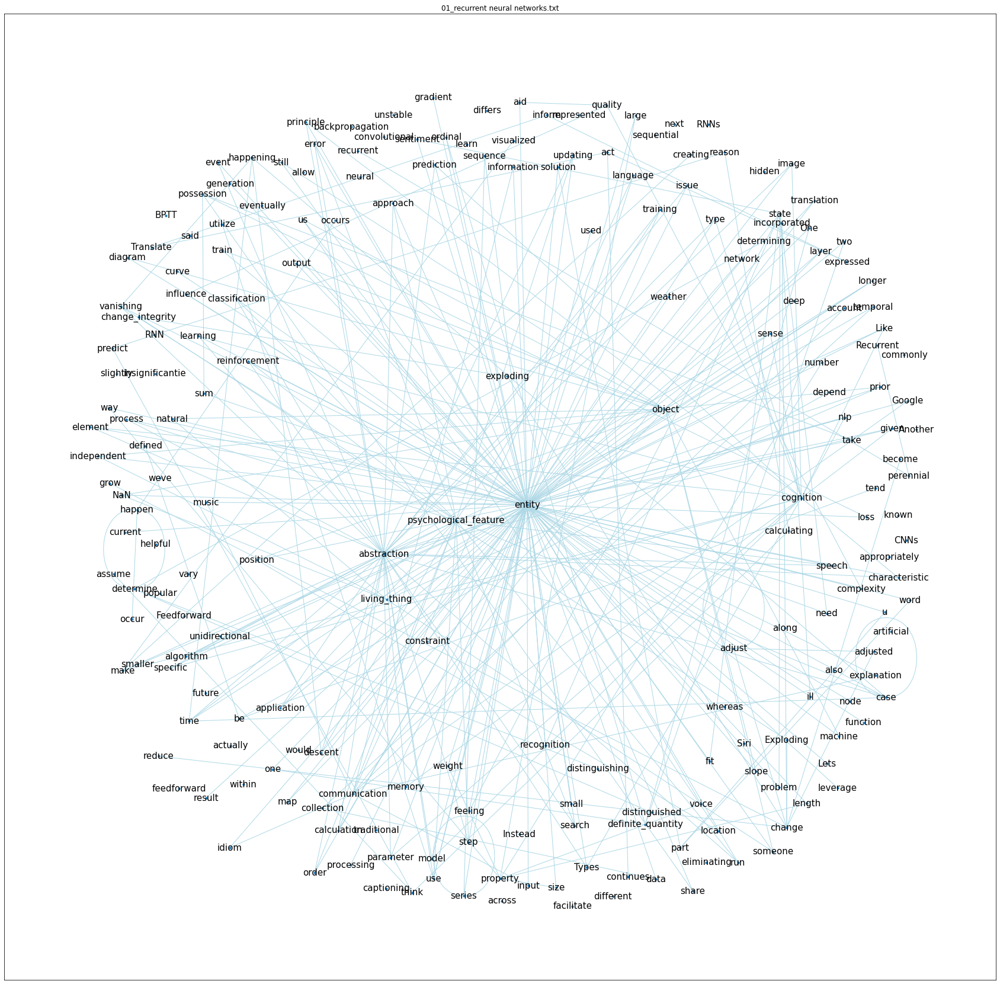

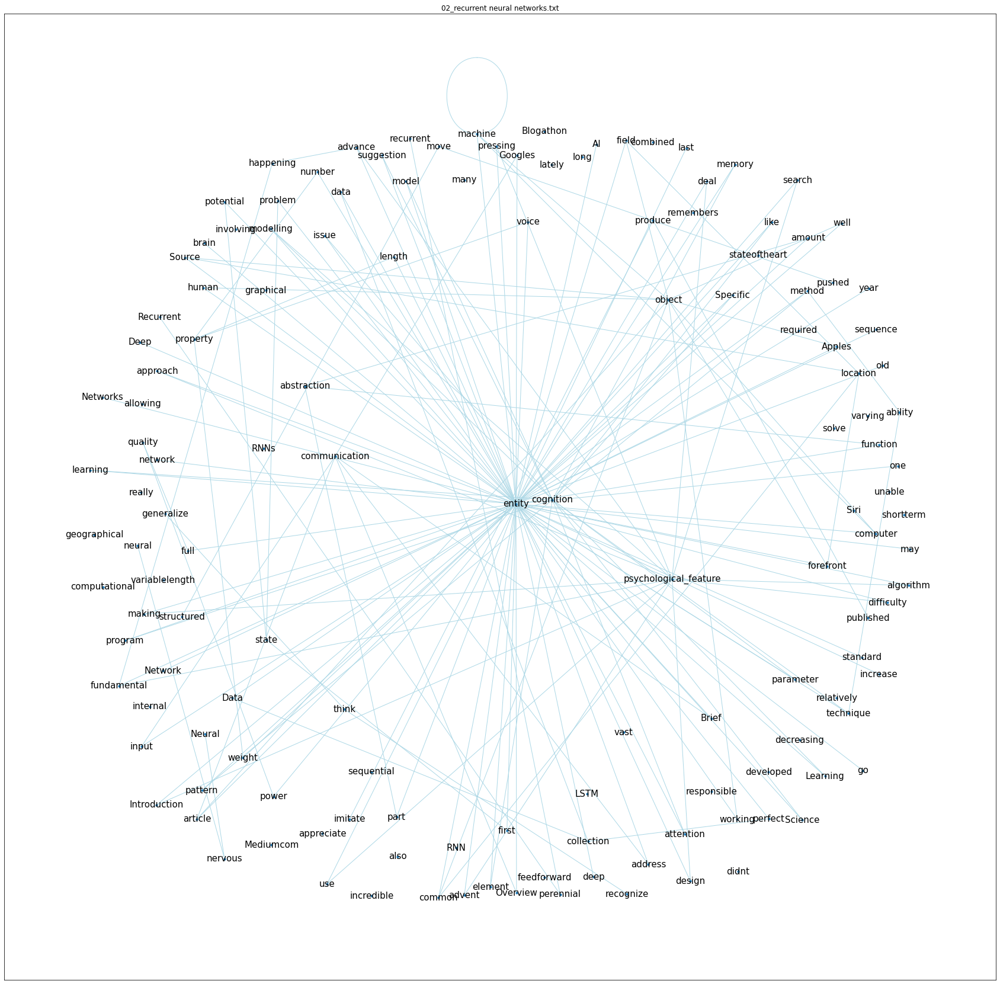

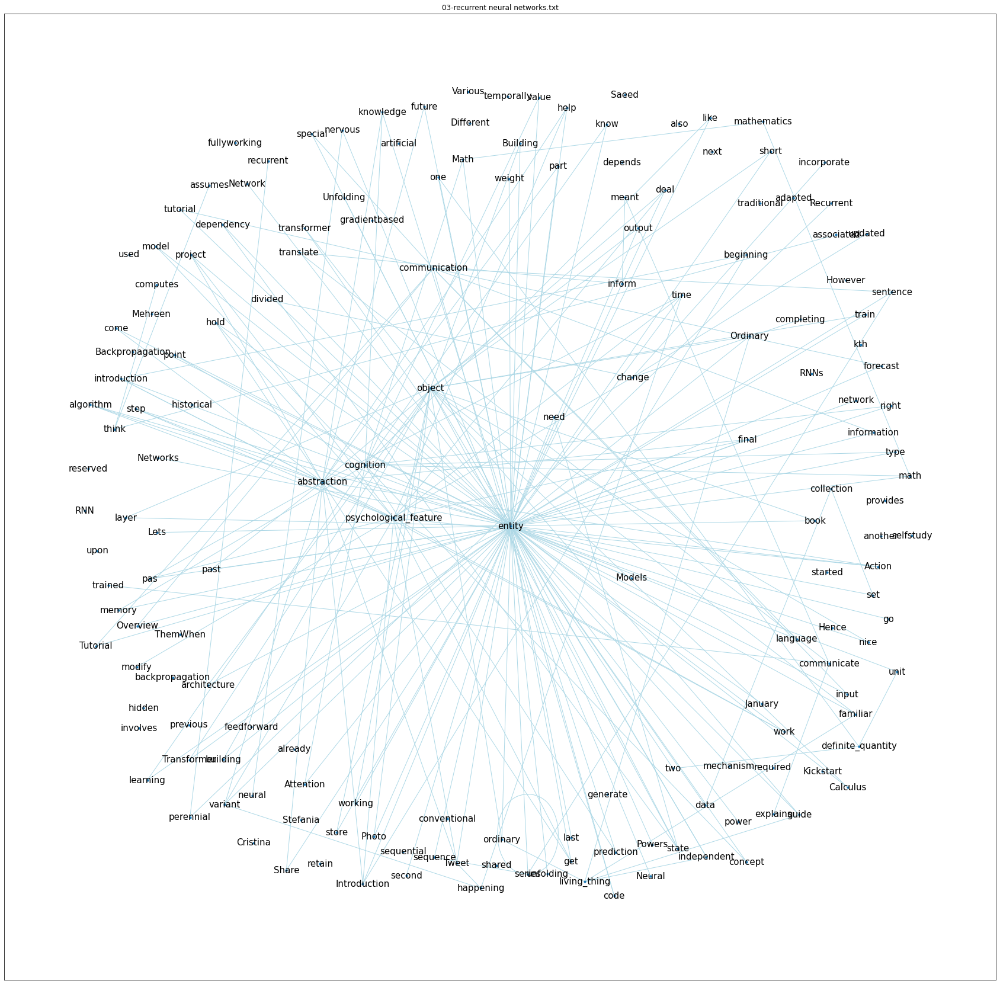

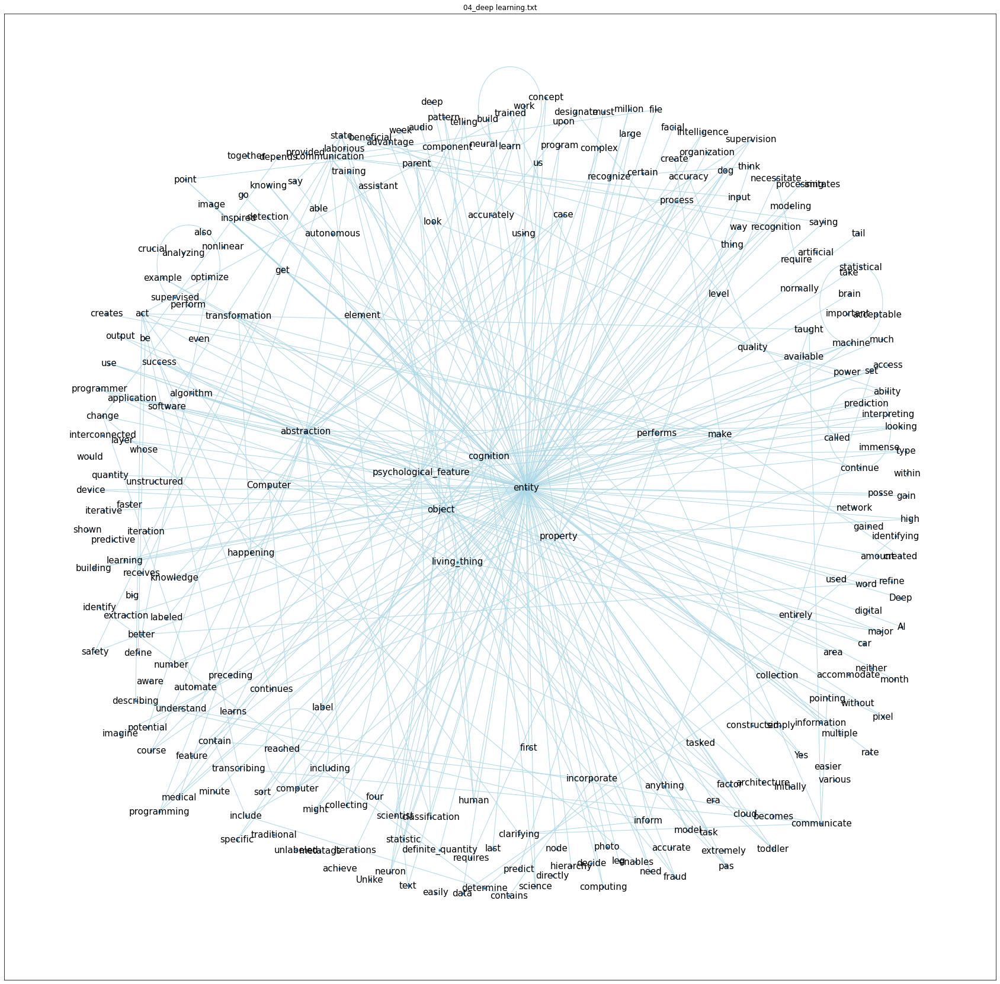

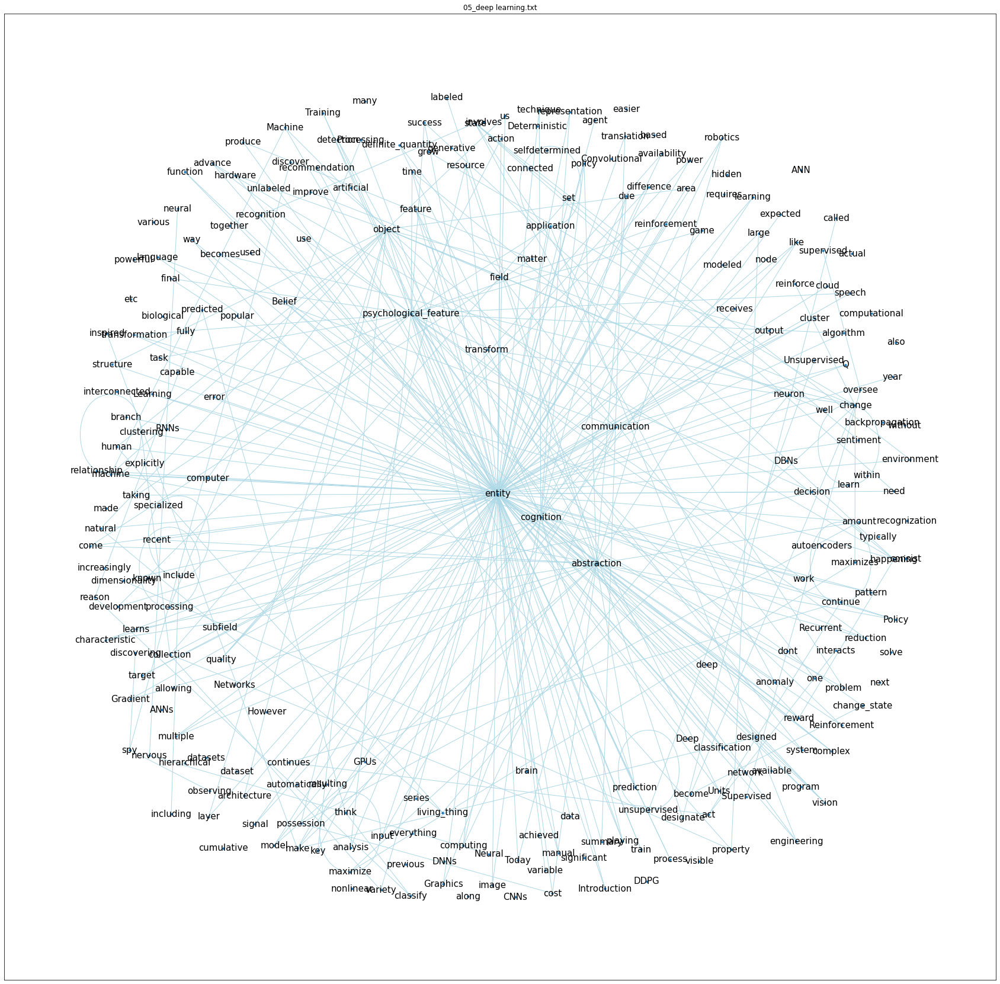

...

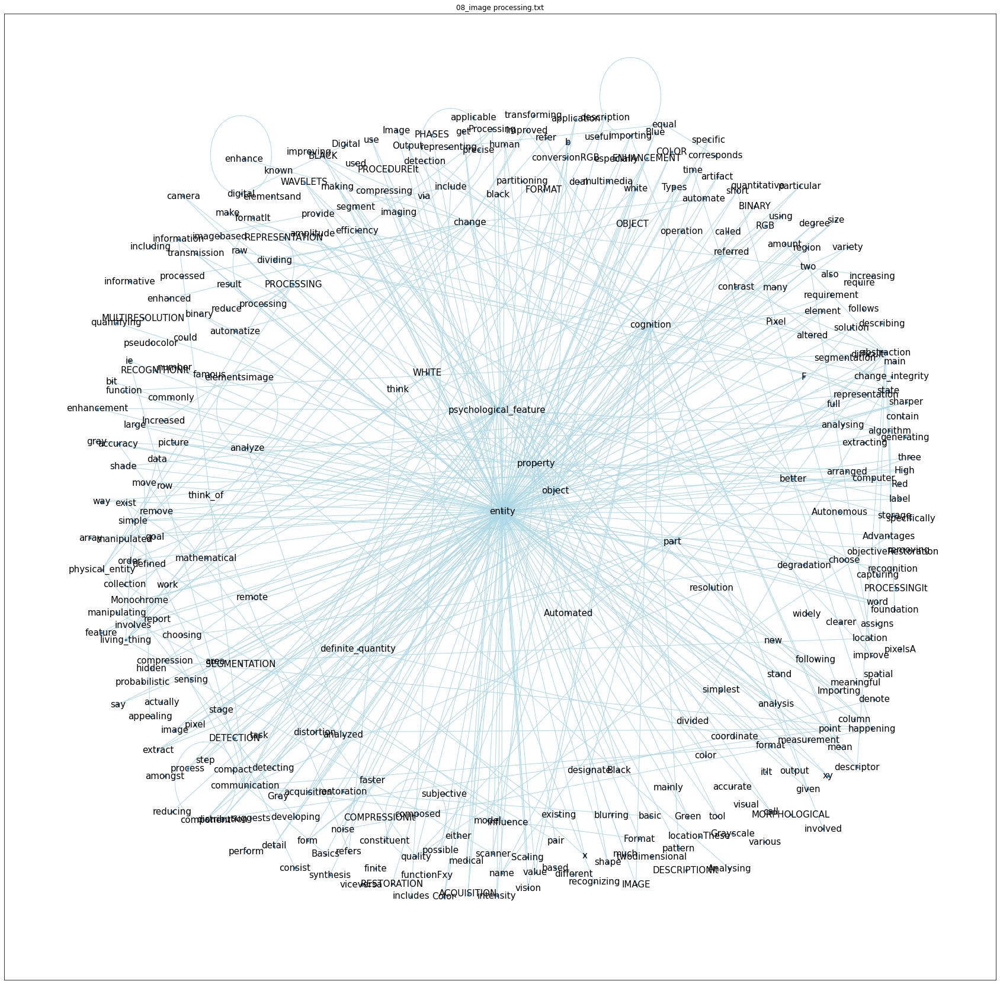

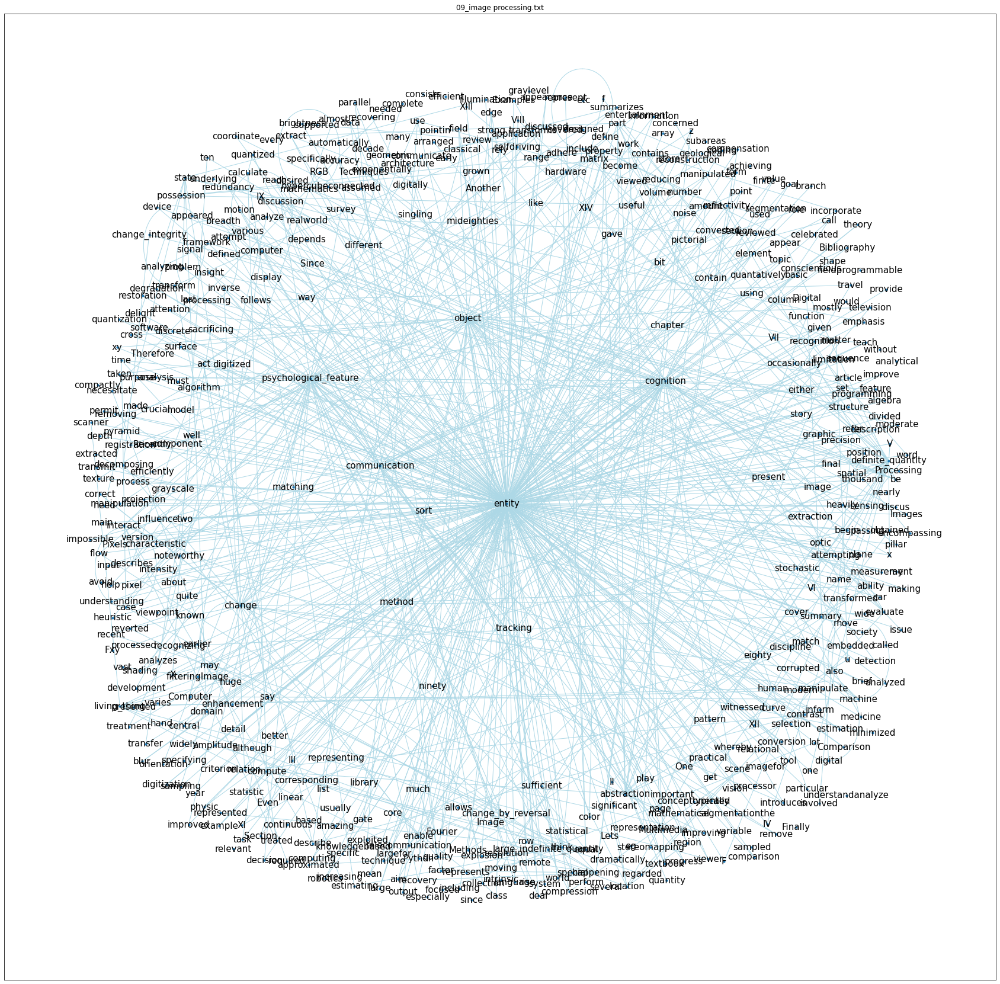

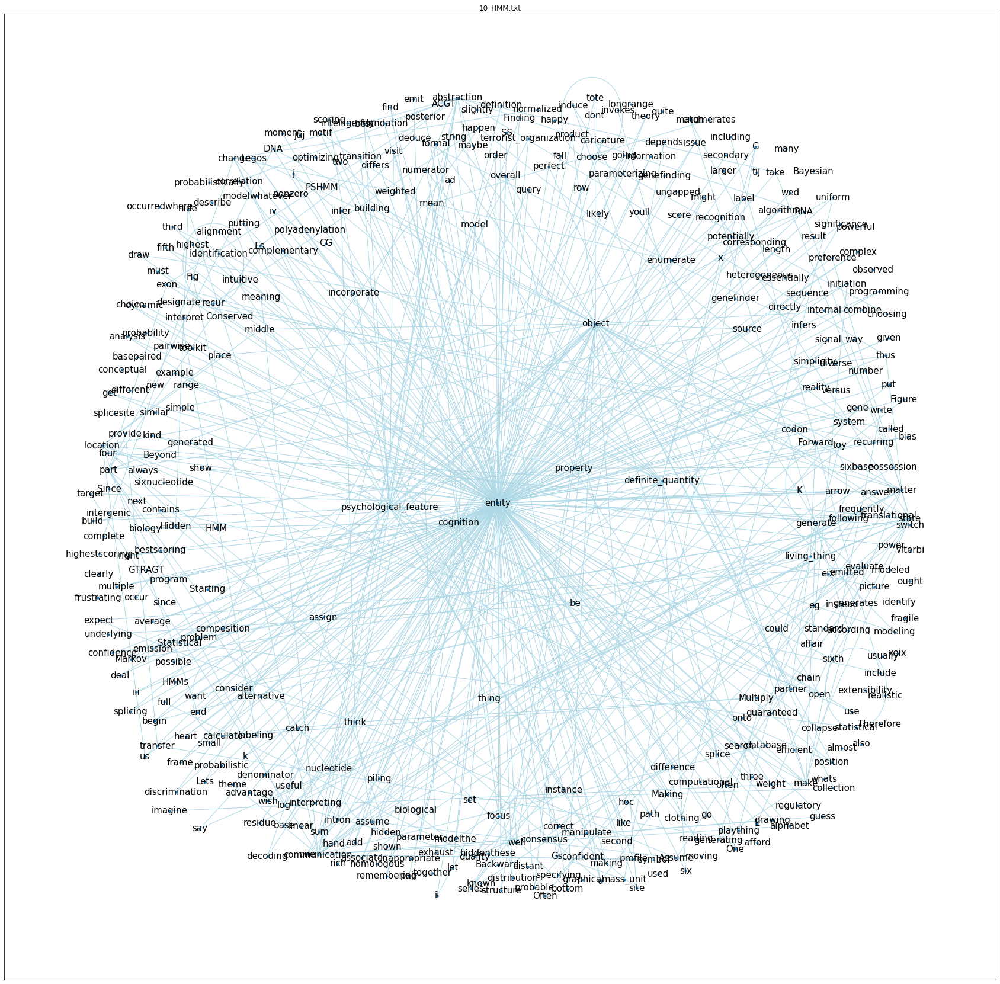

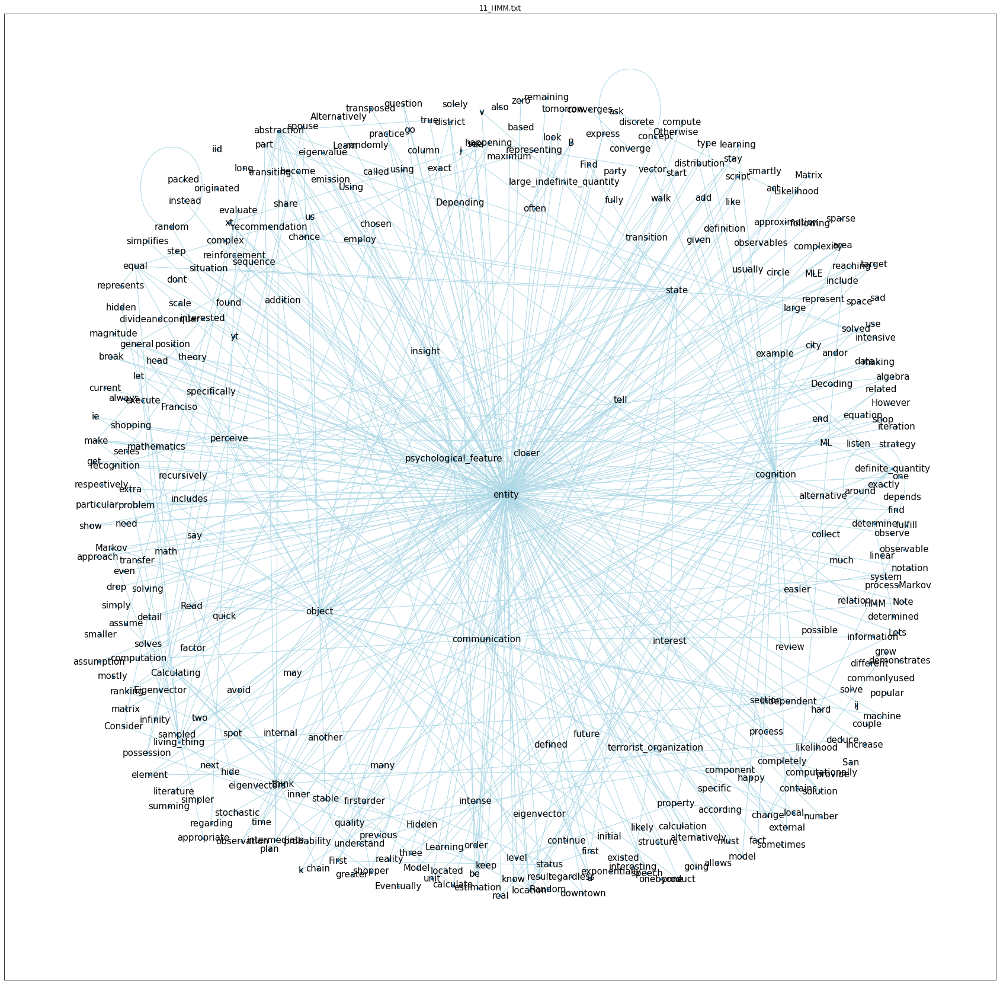

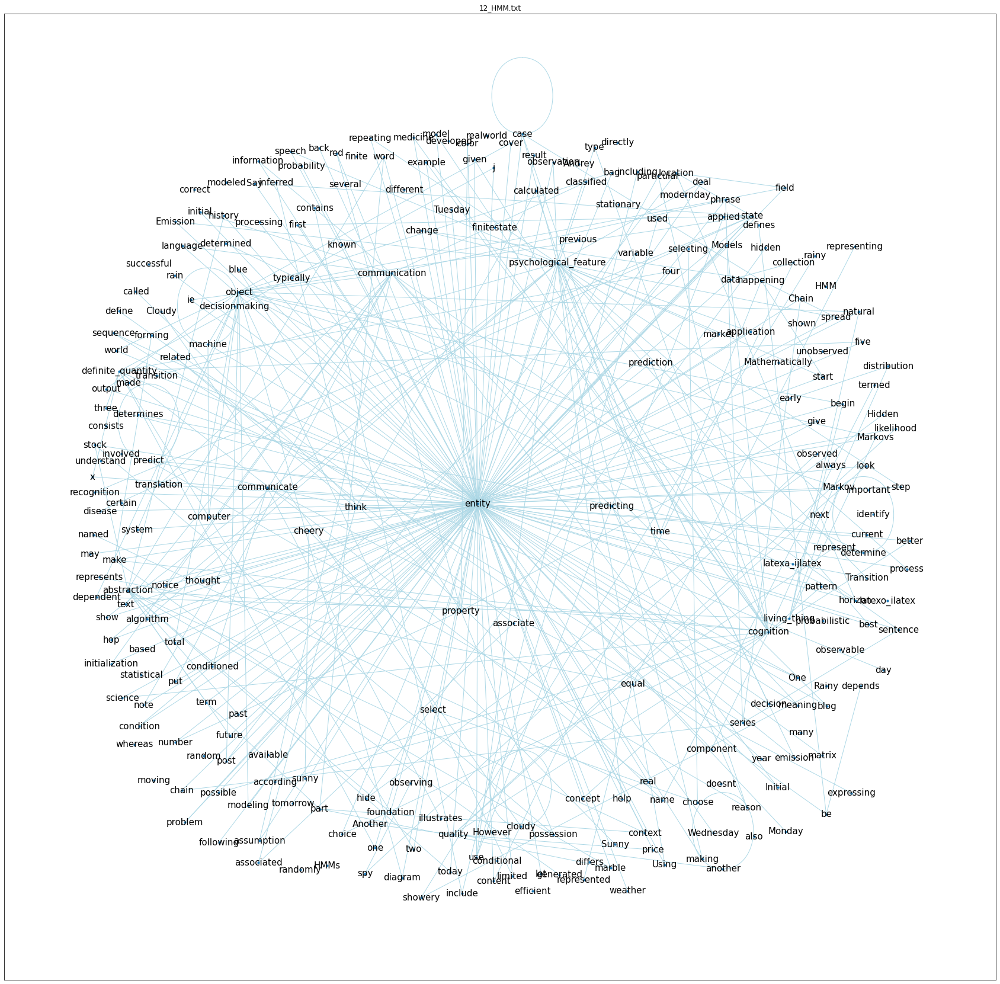

In [5]:
for file in corpus_files.fileids():
    text = corpus_files.raw(file)
    tokens = preprocess(text=text)
    synsets = get_synsets(word=list(set(tokens)))
    graph = createGraph(synsets=synsets)
    visualizeGraph(graph=graph, title=file)